# EMBED: Data Preprocessing

By going through this lecture and notebook, you should be able to:

1. Identify specific DICOM tags for mammography;
2. Understand the relationship between the DICOM tags and the EMBED `metadata.csv`;
3. Perform common image preprocessing techniques for mammograms;
4. Identify common pitfalls or challenges in preprocessing mammograms and understand potential solutions; 
5. Understand the basics of DBT images;
6. Understand the basics of MRI images

# 0. Load Libraries and Prepare Environment

In [1]:
import os
import glob
import pandas as pd
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import rc
from matplotlib.animation import FuncAnimation
from PIL import Image
from IPython.display import display

In [2]:
from tqdm import tqdm

In [3]:
import pydicom
from pydicom.pixel_data_handlers import apply_modality_lut, apply_voi_lut

In [4]:
pd.set_option('display.max_columns', 500)

In [5]:
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [6]:
rc('animation', html='jshtml')

In [7]:
RANDOM_SEED = 2024

## 0.1. Defining Functions

In [8]:
def process_dicom_image(dicom):
    return apply_voi_lut(apply_modality_lut(dicom.pixel_array, dicom), dicom)

In [9]:
def animate_3d_array(data, DPI=150, vmin=np.iinfo(np.int16).min, vmax=np.iinfo(np.int16).max, aspect_ratio = "equal"):
    # Ensure data is a 3D numpy array
    if not isinstance(data, np.ndarray) or data.ndim != 3:
        raise ValueError("Input must be a 3D numpy array")

    fig, ax = plt.subplots(dpi=DPI)
    plt.close(fig)
    
    # Display the first slice
    im = ax.imshow(data[0], cmap='gray', animated=True, vmin=vmin, vmax=vmax, aspect=aspect_ratio)
    
    # Set the title to show the current slice number
    title = ax.set_title('Slice 0')

    def update(frame):
        im.set_array(data[frame])
        title.set_text(f'Slice {frame}')
        return im, title

    # Create the animation
    anim = FuncAnimation(fig, update, frames=data.shape[0], interval=50, blit=True)
    
    return anim

# 1. Load Tables

In [10]:
metadata = pd.read_csv('/fsx/embed/summer-school-24/Theo_session/tables/tutorial_metadata.csv')

In [13]:
metadata

,AcquisitionContextSequence,AcquisitionTime,0_AnatomicRegionSequence_CodeMeaning,0_AnatomicRegionSequence_CodeValue,0_AnatomicRegionSequence_CodingSchemeDesignator,AnodeTargetMaterial,BitsAllocated,BitsStored,BodyPartExamined,BodyPartThickness,BreastImplantPresent,BurnedInAnnotation,Columns,CompressionForce,ContentTime,DetectorBinning,DetectorConditionsNominalFlag,DetectorTemperature,DetectorType,DistanceSourceToDetector,DistanceSourceToPatient,EntranceDose,EntranceDoseInmGy,EstimatedRadiographicMagnificationFactor,Exposure,ExposureControlMode,ExposureControlModeDescription,ExposureInuAs,ExposureTime,ExposureTimeInuS,FieldOfViewHorizontalFlip,FieldOfViewOrigin,FieldOfViewRotation,FilterMaterial,FilterThicknessMaximum,FilterThicknessMinimum,FilterType,FocalSpots,Grid,HalfValueLayer,HighBit,ImageLaterality,ImageType,ImagerPixelSpacing,ImagesInAcquisition,InstanceNumber,IssuerOfPatientID,KVP,LossyImageCompression,Manufacturer,ManufacturerModelName,Modality,OrganDose,OrganExposed,PaddleDescription,PatientAge,PatientOrientation,PatientSex,PerformedProcedureStepDescription,PerformedProcedureStepStartTime,0_PerformedProtocolCodeSequence_CodeMeaning,0_PerformedProtocolCodeSequence_CodeValue,0_PerformedProtocolCodeSequence_CodingSchemeDesignator,PhotometricInterpretation,PixelIntensityRelationship,PixelIntensityRelationshipSign,PixelPaddingValue,PixelRepresentation,PixelSpacing,PositionerPrimaryAngle,PositionerType,PresentationIntentType,PresentationLUTShape,0_ProcedureCodeSequence_CodeMeaning,0_ProcedureCodeSequence_CodeValue,0_ProcedureCodeSequence_CodingSchemeDesignator,0_ProcedureCodeSequence_CodingSchemeVersion,ProtocolName,QualityControlImage,RelativeXRayExposure,RescaleIntercept,RescaleSlope,RescaleType,Rows,SamplesPerPixel,SeriesDescription,SeriesNumber,SeriesTime,SoftwareVersions,0_SourceImageSequence_0_PurposeOfReferenceCodeSequence_CodeMeaning,0_SourceImageSequence_0_PurposeOfReferenceCodeSequence_CodeValue,0_SourceImageSequence_0_PurposeOfReferenceCodeSequence_CodingSchemeDesignator,0_SourceImageSequence_SpatialLocationsPreserved,SpecificCharacterSet,StudyDescription,StudyID,StudyTime,TimeOfLastDetectorCalibration,0_ViewCodeSequence_CodeMeaning,0_ViewCodeSequence_CodeValue,0_ViewCodeSequence_CodingSchemeDesignator,0_ViewCodeSequence_ViewModifierCodeSequence,ViewPosition,WindowCenter,WindowWidth,XRayTubeCurrent,has_pix_array,category,PositionerPrimaryAngleDirection,PixelPaddingRangeLimit,0_ViewCodeSequence_0_ViewModifierCodeSequence_CodeMeaning,0_ViewCodeSequence_0_ViewModifierCodeSequence_CodeValue,0_ViewCodeSequence_0_ViewModifierCodeSequence_CodingSchemeDesignator,AcquisitionDeviceProcessingCode,AcquisitionDeviceProcessingDescription,DerivationDescription,DetectorConfiguration,FieldOfViewDimensions,FieldOfViewShape,Laterality,Sensitivity,ConversionType,0_RelatedSeriesSequence_0_PurposeOfReferenceCodeSequence_CodeMeaning,0_RelatedSeriesSequence_0_PurposeOfReferenceCodeSequence_CodeValue,0_RelatedSeriesSequence_0_PurposeOfReferenceCodeSequence_CodingSchemeDesignator,0_RelatedSeriesSequence_StudyInstanceUID,CollimatorLeftVerticalEdge,CollimatorLowerHorizontalEdge,CollimatorRightVerticalEdge,CollimatorShape,CollimatorUpperHorizontalEdge,CommentsOnRadiationDose,DetectorActiveDimensions,DetectorActiveShape,DetectorElementPhysicalSize,DetectorElementSpacing,DistanceSourceToEntrance,ExposureStatus,0_IconImageSequence_BitsAllocated,0_IconImageSequence_BitsStored,0_IconImageSequence_Columns,0_IconImageSequence_HighBit,0_IconImageSequence_PhotometricInterpretation,0_IconImageSequence_PixelRepresentation,0_IconImageSequence_Rows,0_IconImageSequence_SamplesPerPixel,VOILUTFunction,WindowCenterWidthExplanation,DetectorDescription,png_path,empi_anon,acc_anon,study_date_anon,cohort_num,FillerOrderNumberImagingServiceRequest,LateralityDeriveFlag,ImageLateralityFinal,FinalImageType,spot_mag,png_folder_path,png_filename,SSC_ROI_dest,SSC_match_level,anon_dicom_path,num_roi,PNG_ROI_coords,ROI_source,ROI_match_level,SSC_ROI_flipped,PNG_flipped,

In [11]:
# Sample a dicom file for example purposes
dicom_file = metadata.anon_dicom_path.iloc[3]
dicom_file

'/fsx/embed/emory-mammo/images/dicom/cohort_1/89460365/1.2.846.113972.3.61.1.60142349.20190916.1084944/1.2.847.113690.2750828046.1568447841.4418.81670/1.2.826.0.1.3680043.8.498.93862625780101210579433410196810177521.dcm'

In [12]:
loaded_dicom = pydicom.dcmread(dicom_file)

# 1.1. Mammogram specific tags

- PatientID
- AccessionNumber
- StudyDate
- UIDs [Series, Study, Instance]
- Modality
- Study and Series Description
- Breast Implant Present
- Compression Force and Compression Pressure
- Image Laterality
- View Position

In [14]:
# DICOM Tags --> in parentheses (xxxx, xxxx)
# Followed by DICOM Tag name; Value Representation; Value
loaded_dicom

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 108
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: ''
(0002, 0003) Media Storage SOP Instance UID      UI: ''
(0002, 0010) Transfer Syntax UID                 UI: JPEG Lossless, Non-Hierarchical, First-Order Prediction (Process 14 [Selection Value 1])
(0002, 0012) Implementation Class UID            UI: ''
(0002, 0013) Implementation Version Name         SH: 'EA4 30301.15165'
(0002, 0016) Source Application Entity Title     AE: 'AE_ARCH2'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['DERIVED', 'PRIMARY']
(0008, 0014) Instance Creator UID                UI: ''
(0008, 0016) SOP Class UID                       UI: Digital Mammography X-Ray Image Storage - For Presentation
(0008, 0018) SOP Instan

### 1.1.1. Modality

In [15]:
loaded_dicom.Modality

'MG'

### 1.1.2. Breast Implant Present

In [16]:
loaded_dicom.BreastImplantPresent

'NO'

### ☢️ ***Exercise 1***

*An ongoing challenge is that this tag does not always tell the truth.*

What solution(s) could address this issue?

In [17]:
# Type answer here

### 1.1.3 Compression force & Compression Pressure
Compression force typically ranges from 100-200 Newtons. 

Importance of adequate compression force:
1. Reducing radiation dose
2. Improve image quality

Compression pressure (in kPa) is related to pain during image acquitision. This tag is reported to be available in more recent machines.

Some questions to think about:
- How does compression force or compression pressure affect the screening adherance rate?
- Does this rate vary between different demographics?
- Is it related to density of the breast?

*Reference*

- [Moshina, et al. 2018](https://www.sciencedirect.com/science/article/pii/S0091743518300082)

In [18]:
loaded_dicom.CompressionForce

'97.8604'

In [27]:
loaded_dicom.CompressionPressure  # not all vendors provide this value

AttributeError: 'FileDataset' object has no attribute 'CompressionPressure'

### 1.1.5. Image Laterality

In [20]:
loaded_dicom.ImageLaterality

'R'

### 1.1.6. View Position

In [21]:
loaded_dicom.ViewPosition

'MLO'

There is another tag that can also provide information regarding view position.

In [22]:
loaded_dicom.ViewCodeSequence

<Sequence, length 1>

In [23]:
loaded_dicom.ViewCodeSequence[0]

(0008, 0100) Code Value                          SH: 'R-10226'
(0008, 0102) Coding Scheme Designator            SH: 'SNM3'
(0008, 0104) Code Meaning                        LO: 'medio-lateral oblique'
(0054, 0222)  View Modifier Code Sequence  0 item(s) ---- 

# 1.2. Nested DICOM Tags

![Nested DICOM Tags](https://i.sstatic.net/JMyoM.gif, "Nested DICOM Tags")

Image Source: https://stackoverflow.com/questions/46690392/how-to-read-nested-child-dicom-tags-from-sequences-using-fo-dicom

In [24]:
loaded_dicom.ViewCodeSequence

<Sequence, length 1>

In [25]:
for sequence in loaded_dicom.ViewCodeSequence:
    print(sequence)

(0008, 0100) Code Value                          SH: 'R-10226'
(0008, 0102) Coding Scheme Designator            SH: 'SNM3'
(0008, 0104) Code Meaning                        LO: 'medio-lateral oblique'
(0054, 0222)  View Modifier Code Sequence  0 item(s) ---- 


In [26]:
loaded_dicom.ViewCodeSequence[0].CodeMeaning

'medio-lateral oblique'

[Click to see more information regarding Coding Schemes](https://dicom.nema.org/medical/dicom/current/output/chtml/part16/chapter_8.html#chapter_8.1)

### ☢️ ***Exercise 2***

If `loaded_dicom.ViewPosition` contains the same information as `loaded_dicom.ViewCodeSequence[0].CodeMeaning`, which tag do you use? Why?

In [28]:
#Both tags contain same info, lloaded_dicom.ViewCodeSequence[0] would be better, 

**Another example**

In [29]:
loaded_dicom.SourceImageSequence

<Sequence, length 1>

In [30]:
loaded_dicom.SourceImageSequence[0]

(0008, 1150) Referenced SOP Class UID            UI: ''
(0008, 1155) Referenced SOP Instance UID         UI: ''
(0028, 135a) Spatial Locations Preserved         CS: 'YES'
(0040, a170)  Purpose of Reference Code Sequence  1 item(s) ---- 
   (0008, 0100) Code Value                          SH: '121322'
   (0008, 0102) Coding Scheme Designator            SH: 'DCM'
   (0008, 0104) Code Meaning                        LO: 'Source image for image processing operation'
   ---------

In [31]:
loaded_dicom.SourceImageSequence[0].PurposeOfReferenceCodeSequence[0]

(0008, 0100) Code Value                          SH: '121322'
(0008, 0102) Coding Scheme Designator            SH: 'DCM'
(0008, 0104) Code Meaning                        LO: 'Source image for image processing operation'

In [32]:
loaded_dicom.SourceImageSequence[0].PurposeOfReferenceCodeSequence[0].CodeMeaning

'Source image for image processing operation'

# 2.1. The Structure of EMBED `Metadata.csv`

The majority of columns in `metadata.csv` are extracted DICOM tags.

In [33]:
for i in range(len(metadata.columns)):
    print(i+1, list(metadata.columns)[i])

1 AcquisitionContextSequence
2 AcquisitionTime
3 0_AnatomicRegionSequence_CodeMeaning
4 0_AnatomicRegionSequence_CodeValue
5 0_AnatomicRegionSequence_CodingSchemeDesignator
6 AnodeTargetMaterial
7 BitsAllocated
8 BitsStored
9 BodyPartExamined
10 BodyPartThickness
11 BreastImplantPresent
12 BurnedInAnnotation
13 Columns
14 CompressionForce
15 ContentTime
16 DetectorBinning
17 DetectorConditionsNominalFlag
18 DetectorTemperature
19 DetectorType
20 DistanceSourceToDetector
21 DistanceSourceToPatient
22 EntranceDose
23 EntranceDoseInmGy
24 EstimatedRadiographicMagnificationFactor
25 Exposure
26 ExposureControlMode
27 ExposureControlModeDescription
28 ExposureInuAs
29 ExposureTime
30 ExposureTimeInuS
31 FieldOfViewHorizontalFlip
32 FieldOfViewOrigin
33 FieldOfViewRotation
34 FilterMaterial
35 FilterThicknessMaximum
36 FilterThicknessMinimum
37 FilterType
38 FocalSpots
39 Grid
40 HalfValueLayer
41 HighBit
42 ImageLaterality
43 ImageType
44 ImagerPixelSpacing
45 ImagesInAcquisition
46 Instanc

In `metadata` file, the nested DICOM tags follow the following structure:

`0_[Parent Tag]_[Child Tag]`.

For example: '0_AnatomicRegionSequence_CodingSchemeDesignator'

# 3. Working with DICOM Images

## 3.1. Load DICOM Image Pixels

In [34]:
loaded_dicom[0x7FE0,0x0010]

(7fe0, 0010) Pixel Data                          OB: Array of 8709004 elements

In [35]:
loaded_dicom[0x7FE0,0x0010].keyword

'PixelData'

In [36]:
loaded_dicom.pixel_array

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint16)

In [37]:
image = loaded_dicom.pixel_array

In [38]:
print(image.shape)  # (Height, Width)

(4096, 3328)


In [39]:
print(image.dtype)

uint16


## 3.2 View a DICOM Image

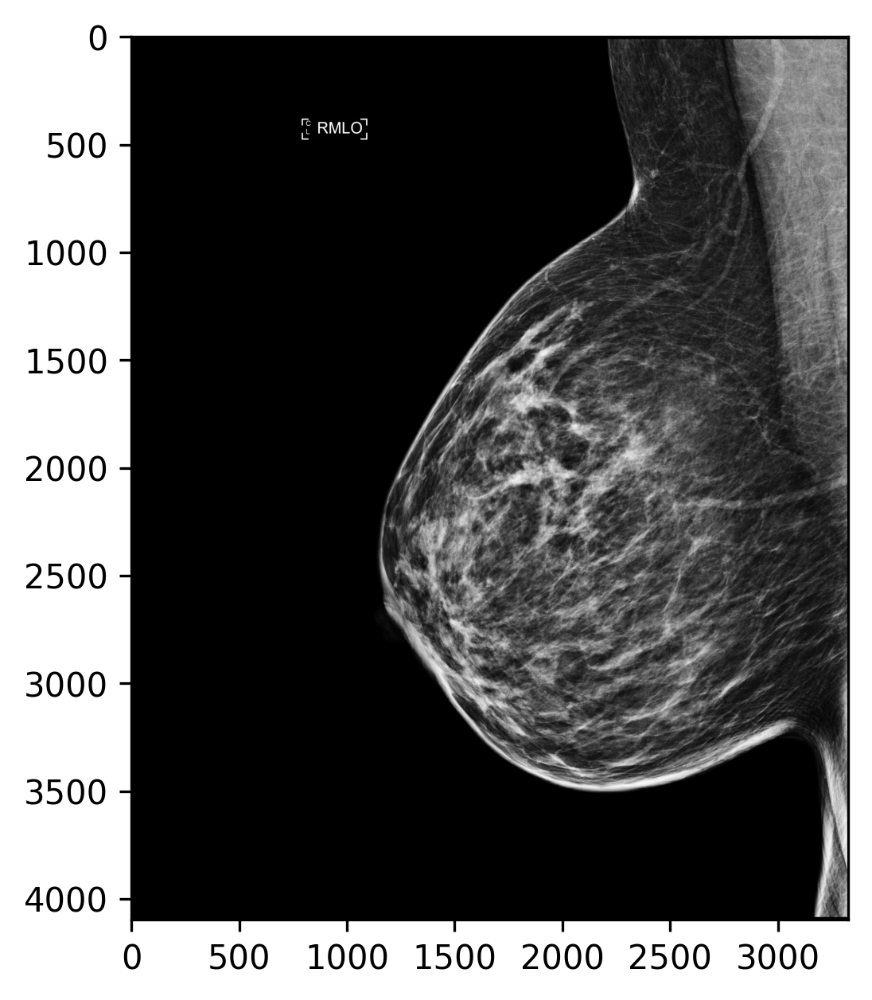

In [40]:
plt.figure(dpi=300)
plt.imshow(loaded_dicom.pixel_array, 'gray')
plt.show()

# 4. Common Image Preprocessing Techniques in Mammography for Deep Learning

# 4.1. Applying Modality LUT and VOI LUT

Review of the Modality LUT and VOI LUT discussed on Monday

### 4.1.1. Applying Modality Transforms
The raw Pixel Data in a DICOM file may not be in the modality units. Therefore, we first need to apply a modality transformation to standardize the units.

There are 2 ways of transforming the values:
1. Using the Rescale Intercept and Rescale Slope
We apply the Rescale Slope and Intercept using the following equation:

$$\text{Output Value} = m \cdot \text{Stored Value} + b$$

where *m* is the Rescale Slope and *b* is the Rescale Intercept

2. Using the Modality LUT
This method uses a Look Up Table which will specify what a pixel value will be transformed into.

In a DICOM file, only one of the above method is available.


### 4.1.2. Applying the VOI LUT

![VOI LUT](figures/voi_lut.png)

In [41]:
metadata.Manufacturer.value_counts()

Manufacturer
HOLOGIC, Inc.         25
GE MEDICAL SYSTEMS    25
Name: count, dtype: int64

In [42]:
ge = metadata[metadata.Manufacturer.str.contains('GE')]
holo = metadata[metadata.Manufacturer.str.contains('HOLO')]

In [43]:
ge.shape

(25, 173)

/opt/tljh/user/envs/pandas/lib/python3.11/site-packages/pydicom/pixel_data_handlers/util.py:423: UserWarning: Applying a VOI LUT on a float input array may give incorrect results
  warnings.warn(


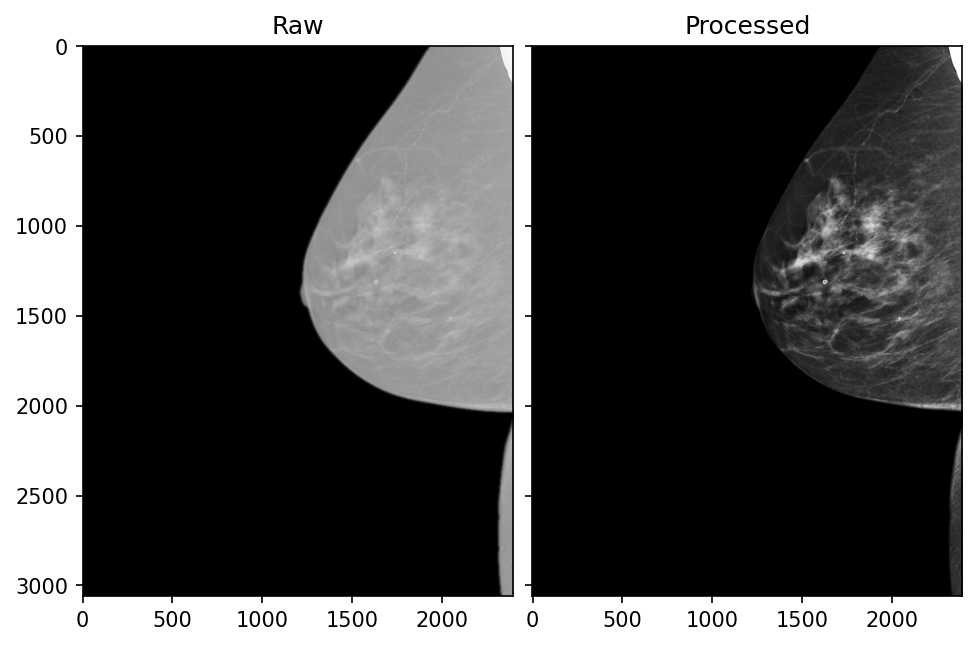

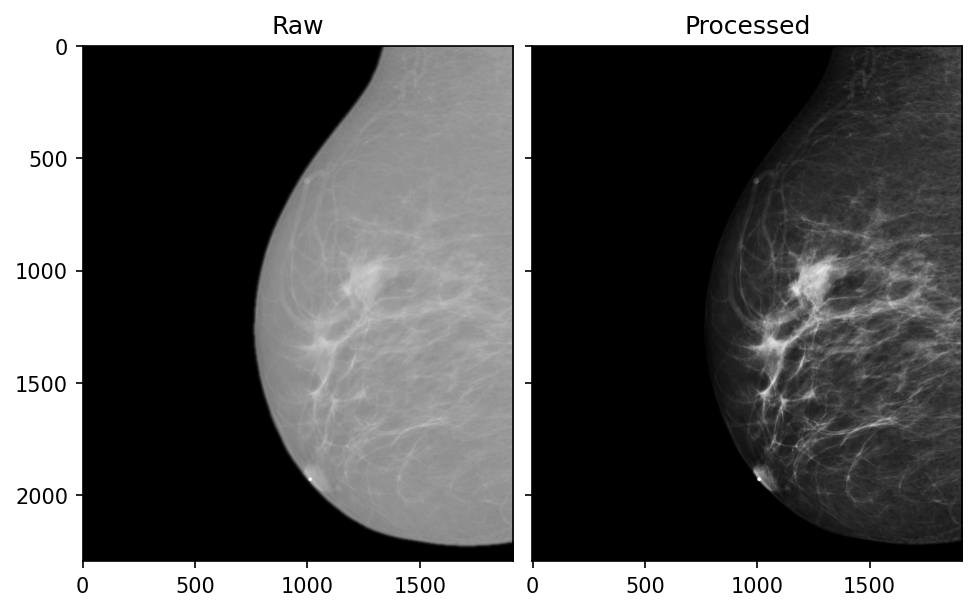

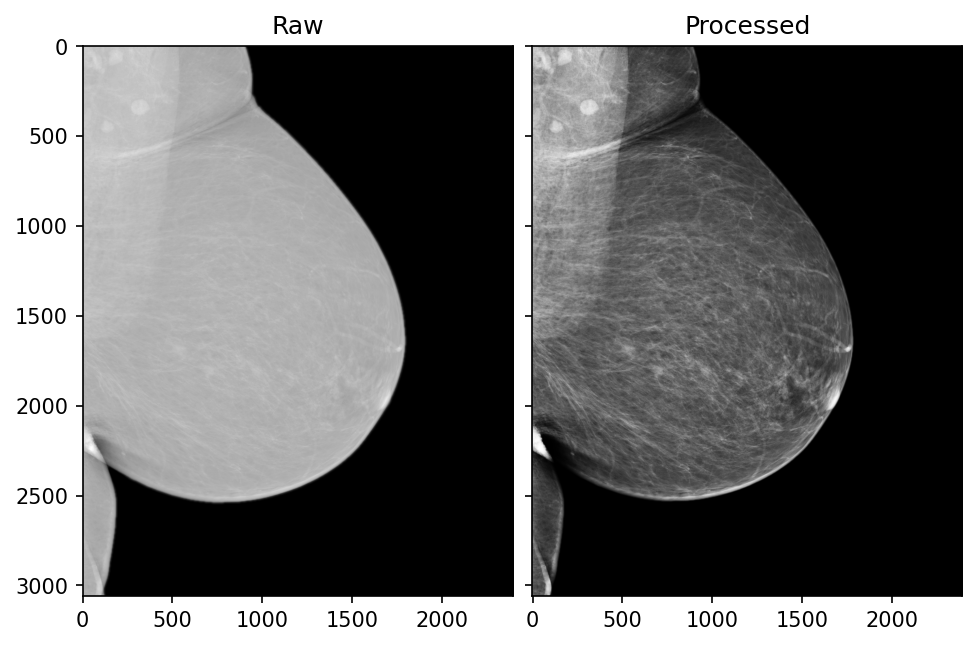

In [44]:
# sample_df = ge.sample(frac=1, random_state=RANDOM_SEED)
sample_df = ge.sample(3, random_state=RANDOM_SEED)
for i in range(sample_df.shape[0]):
    dcm = pydicom.dcmread(sample_df.anon_dicom_path.iloc[i])
    fig, axs = plt.subplots(1, 2, dpi=150, constrained_layout=True, sharey=True)
    axs[0].imshow(dcm.pixel_array, 'gray')
    axs[1].imshow(process_dicom_image(dcm), 'gray')
    axs[0].set_title("Raw")
    axs[1].set_title("Processed")
    plt.show()

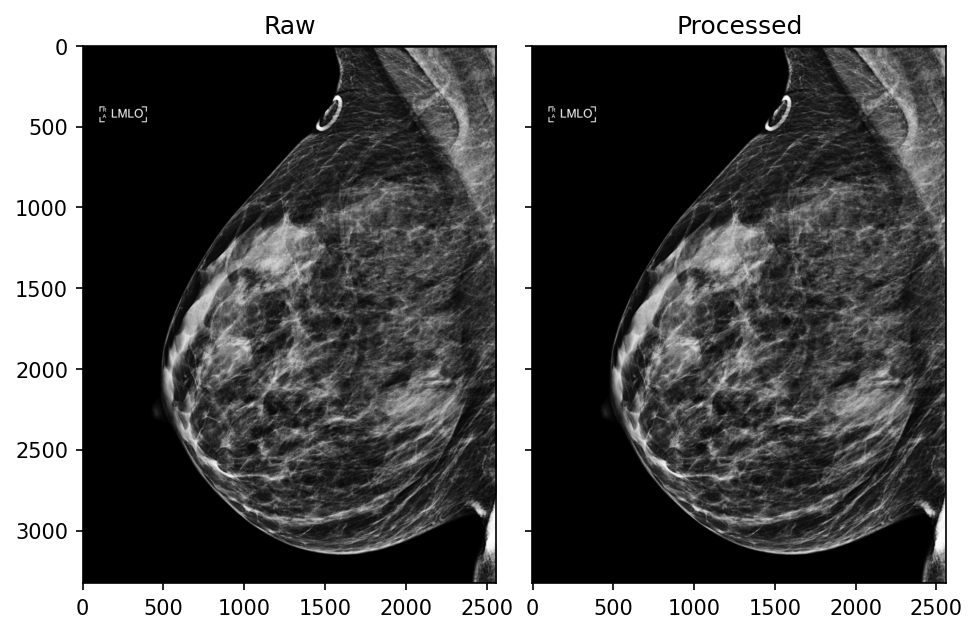

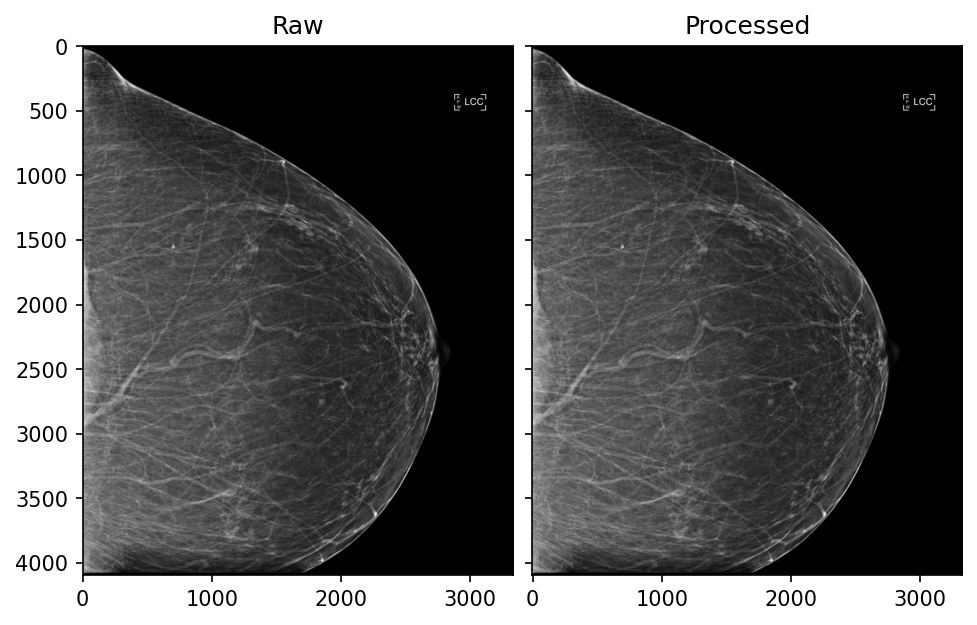

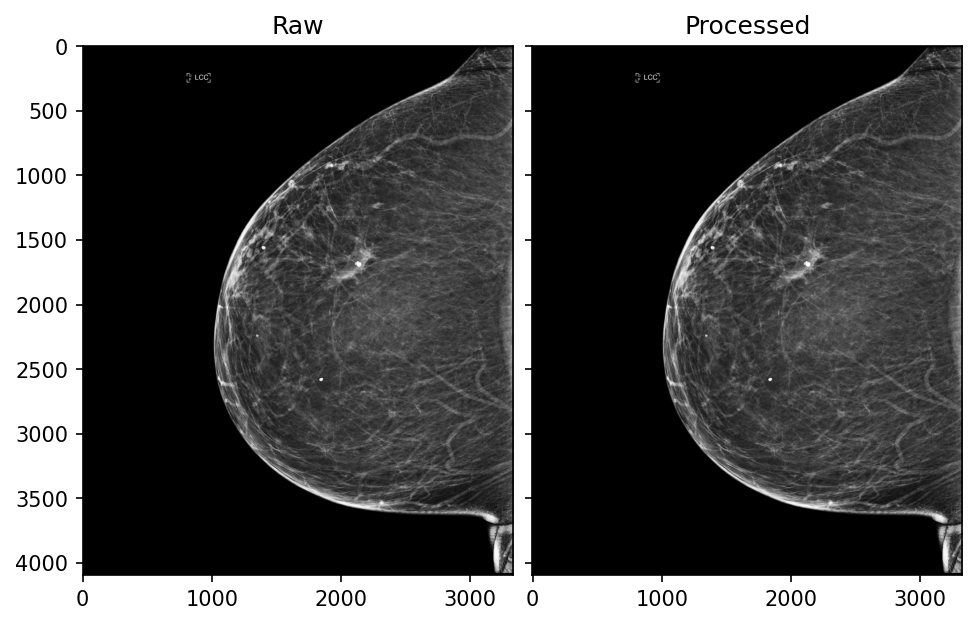

In [45]:
# sample_df = holo.sample(frac=1, random_state=RANDOM_SEED)
sample_df = holo.sample(3, random_state=RANDOM_SEED)
for i in range(sample_df.shape[0]):
    dcm = pydicom.dcmread(sample_df.anon_dicom_path.iloc[i])
    fig, axs = plt.subplots(1, 2, dpi=150, constrained_layout=True, sharey=True)
    axs[0].imshow(dcm.pixel_array, 'gray')
    axs[1].imshow(process_dicom_image(dcm), 'gray')
    axs[0].set_title("Raw")
    axs[1].set_title("Processed")
    plt.show()

### ☢️ ***Exercise 3***

Discuss with the person next to you, what you would do if you obtained an external dataset that has the VOI LUT removed?

# 4.2. Flipping images to face the same orientation

There are several reasons why we want to flip the images to face the same direction:

1. **Baseline**: Flipping the images to face the same direction creates a consistent baseline for further downstream tasks.
2. **Data augmentation**: In deep learning, we want to increase the variablity of the training data by performing random flippings, rotations, or scalings. With a consistent baseline, it is easier to control the augmentation pipeline.
3. **Comparative Analysis**: Aligning images in the same orientation makes it easier to compare different images. It is also an initial step to perform image registration.

The following cell is reused from: https://github.com/Emory-HITI/EMBED_Open_Data/blob/main/DCM_to_PNG.ipynb


In [46]:
# Get DICOM image metadata
class DCM_Tags():
    def __init__(self, img_dcm):
        try:
            self.laterality = img_dcm.ImageLaterality
        except AttributeError:
            self.laterality = np.nan
            
        try:
            self.view = img_dcm.ViewPosition
        except AttributeError:
            self.view = np.nan
            
        try:
            self.orientation = img_dcm.PatientOrientation
        except AttributeError:
            self.orientation = np.nan

# Check whether DICOM should be flipped
def check_dcm(imgdcm):
    # Get DICOM metadata
    tags = DCM_Tags(imgdcm)
    
    # If image orientation tag is defined
    if ~pd.isnull(tags.orientation):
        # CC view
        if tags.view == 'CC':
            if tags.orientation[0] == 'P':
                flipHorz = True
            else:
                flipHorz = False
            
            if (tags.laterality == 'L') & (tags.orientation[1] == 'L'):
                flipVert = True
            elif (tags.laterality == 'R') & (tags.orientation[1] == 'R'):
                flipVert = True
            else:
                flipVert = False
        
        # MLO or ML views
        elif (tags.view == 'MLO') | (tags.view == 'ML'):
            if tags.orientation[0] == 'P':
                flipHorz = True
            else:
                flipHorz = False
            
            if (tags.laterality == 'L') & ((tags.orientation[1] == 'H') | (tags.orientation[1] == 'HL')):
                flipVert = True
            elif (tags.laterality == 'R') & ((tags.orientation[1] == 'H') | (tags.orientation[1] == 'HR')):
                flipVert = True
            else:
                flipVert = False
        
        # Unrecognized view
        else:
            flipHorz = False
            flipVert = False
            
    # If image orientation tag is undefined
    else:
        # Flip RCC, RML, and RMLO images
        if (tags.laterality == 'R') & ((tags.view == 'CC') | (tags.view == 'ML') | (tags.view == 'MLO')):
            flipHorz = True
            flipVert = False
        else:
            flipHorz = False
            flipVert = False
            
    return flipHorz, flipVert

In [47]:
# Check if a horizontal flip is necessary
original_image = process_dicom_image(loaded_dicom)
horz, _ = check_dcm(loaded_dicom)
if horz:
    # Flip img horizontally
    flipped_image = np.fliplr(original_image)

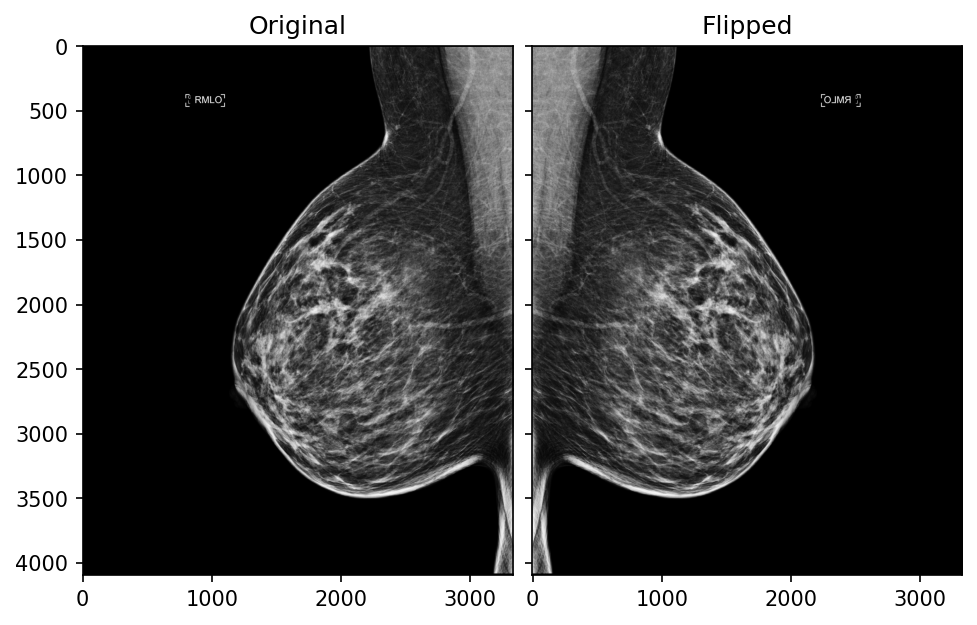

In [48]:
fig, axs = plt.subplots(1, 2, dpi=150, constrained_layout=True, sharey=True)
axs[0].imshow(original_image, 'gray')
axs[1].imshow(flipped_image, 'gray')
axs[0].set_title("Original")
axs[1].set_title("Flipped")
plt.show()

# 4.3. Masking out breast tissue

Some manufacturers burn in additional information to the images, such as ViewPosition markers (e.g. RMLO), dates, initials, etc.

We want to remove these markers to only obtain the breast tissue.

Why do we want to do this?

In [49]:
def select_island(img_):
    _, bin_mask = cv2.threshold(img_, 0.05, 1, cv2.THRESH_BINARY)
    
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(bin_mask.astype(np.uint8), connectivity=8)
    
    # Filter out small components (you can adjust the threshold as needed)
    min_area_threshold = 20000  # minimum area to keep
    island_mask = np.zeros_like(bin_mask.astype(np.uint8))
    for label in range(1, num_labels):  # Exclude background (label 0)
        area = stats[label, cv2.CC_STAT_AREA]
        if area >= min_area_threshold:
            island_mask[labels == label] = 1

    return bin_mask, island_mask

In [50]:
_, binary_mask = cv2.threshold(flipped_image, np.ptp(flipped_image) * 0.0005 + flipped_image.min(), flipped_image.max(), cv2.THRESH_BINARY)

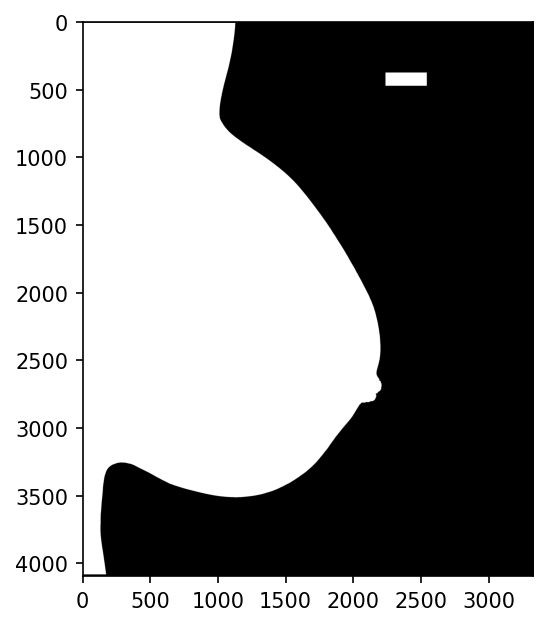

In [51]:
plt.figure(dpi=150)
plt.imshow(binary_mask, 'gray')
plt.show()

In [52]:
num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(binary_mask.astype(np.uint8), connectivity=8)

In [53]:
# Get the area
largest_area = 0
label_with_largest_area = None
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    print("Label:", i, "--> Area:", area)
    if area > largest_area:
        largest_area = area
        label_with_largest_area = i

Label: 1 --> Area: 5820072
Label: 2 --> Area: 29890


In [54]:
island_mask = np.zeros_like(binary_mask.astype(np.uint8))
island_mask[labels == label_with_largest_area] = 1

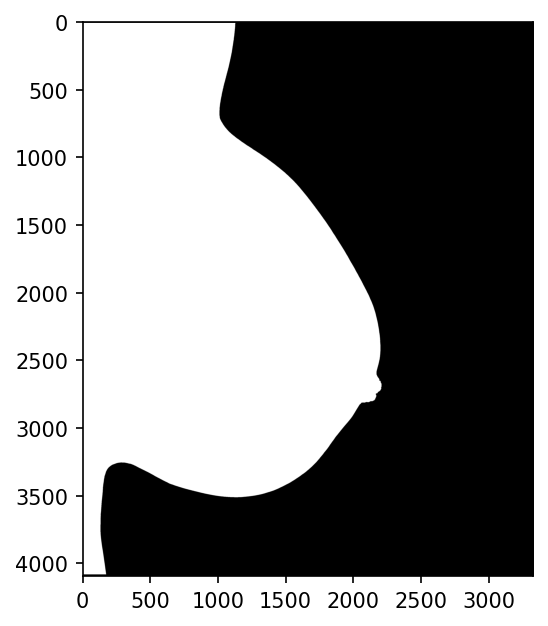

In [55]:
plt.figure(dpi=150)
plt.imshow(island_mask, 'gray')
plt.show()

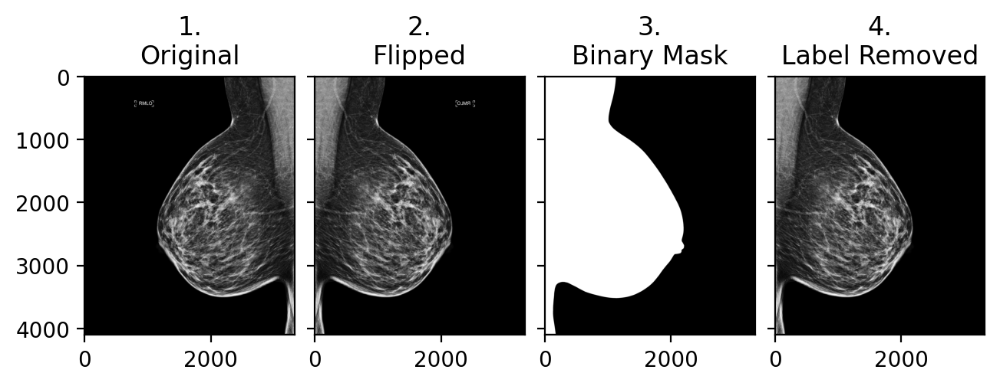

In [56]:
flipped_image_no_label = flipped_image * island_mask

fig, axs = plt.subplots(1, 4, dpi=200, constrained_layout=True, sharey=True)
axs[0].imshow(original_image, 'gray')
axs[1].imshow(flipped_image, 'gray')
axs[2].imshow(island_mask, 'gray')
axs[3].imshow(flipped_image_no_label, 'gray')
axs[0].set_title("1.\nOriginal")
axs[1].set_title("2.\nFlipped")
axs[2].set_title("3.\nBinary Mask")
axs[3].set_title("4.\nLabel Removed")
plt.show()

# 4.4. Crop to Breast Tissue

Several points of importance of cropping to breast tissue:

1. Surrounding air do not contain important information* --> saves disk space;
2. Provides ease and more flexibility if one requires further processing steps, for example padding;
2. Elimination of artefacts;

Here's an example of artifacts in air pixels which may be due to scattered radiation.

It is noticable in the Heatmap subimage that the model was picking up these artefacts as signal instead of the breast.

![](figures/air_artifacts.png "Example of the presence of scattered radiation ")


In [57]:
def crop_zeros(image, img_mask_):
    points = np.argwhere(img_mask_.sum(axis=0))
    left_boundary = points.min()
    right_boundary = points.max()
    
    points = np.argwhere(img_mask_.sum(axis=1))
    top_boundary = points.min()
    bottom_boundary = points.max()

    return image[top_boundary:bottom_boundary, left_boundary: right_boundary]

In [58]:
cropped_img = crop_zeros(flipped_image_no_label, island_mask)

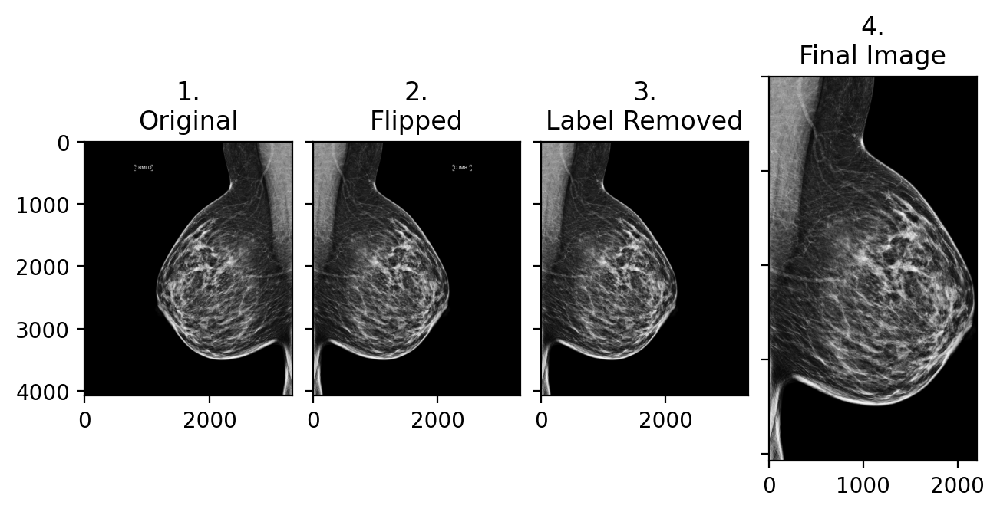

In [59]:
flipped_image_no_label = flipped_image * island_mask

fig, axs = plt.subplots(1, 4, dpi=200, constrained_layout=True, sharey=True)
axs[0].imshow(original_image, 'gray')
axs[1].imshow(flipped_image, 'gray')
axs[2].imshow(flipped_image_no_label, 'gray')
axs[3].imshow(cropped_img, 'gray')
axs[0].set_title("1.\nOriginal")
axs[1].set_title("2.\nFlipped")
axs[2].set_title("3.\nLabel Removed")
axs[3].set_title("4.\nFinal Image")
plt.show()

# 4.5. Saving to PNG

In [60]:
# Convert pixel array to PNG as a 16-bit greyscale
image_to_save = cropped_img.astype(np.double)

# Rescale grey scale between 0-65535
image_to_save = (np.maximum(image_to_save, 0) / image_to_save.max()) * 65535.0

# Convert to uint16
image_to_save = np.uint16(image_to_save)

output_png_path = f"./output/{loaded_dicom.SOPInstanceUID}.png"

if not os.path.exists("./output/"):
    os.makedirs("./output/")

image = Image.fromarray(image_to_save.astype(np.uint16))
image.save(output_png_path)

# 4.6. Common Normalization Techniques

1. Min-max normalization
2. Standardization

# 4.6.1. Min-Max Normalization

The most common Min-Max Normalization technique is transforming the pixel distribution between 0 and 1.

The steps are as follows:

1. Calculate the minimum and maximum pixel values of the image
2. Subtract the image with it's minimum value
3. Divide the results with the range of pixel values, i.e. Maximum minus Minimum (max - min)

In [61]:
img_max = cropped_img.max()
img_min = cropped_img.min()

In [62]:
normalized_img = (cropped_img - img_min) / (img_max - img_min)

In [63]:
normalized_img.min()

0.0

In [64]:
normalized_img.max()

1.0

Cropped Image: (min=0.00, max=4022.00)
Normalized Image: (min=0.00, max=1.00)


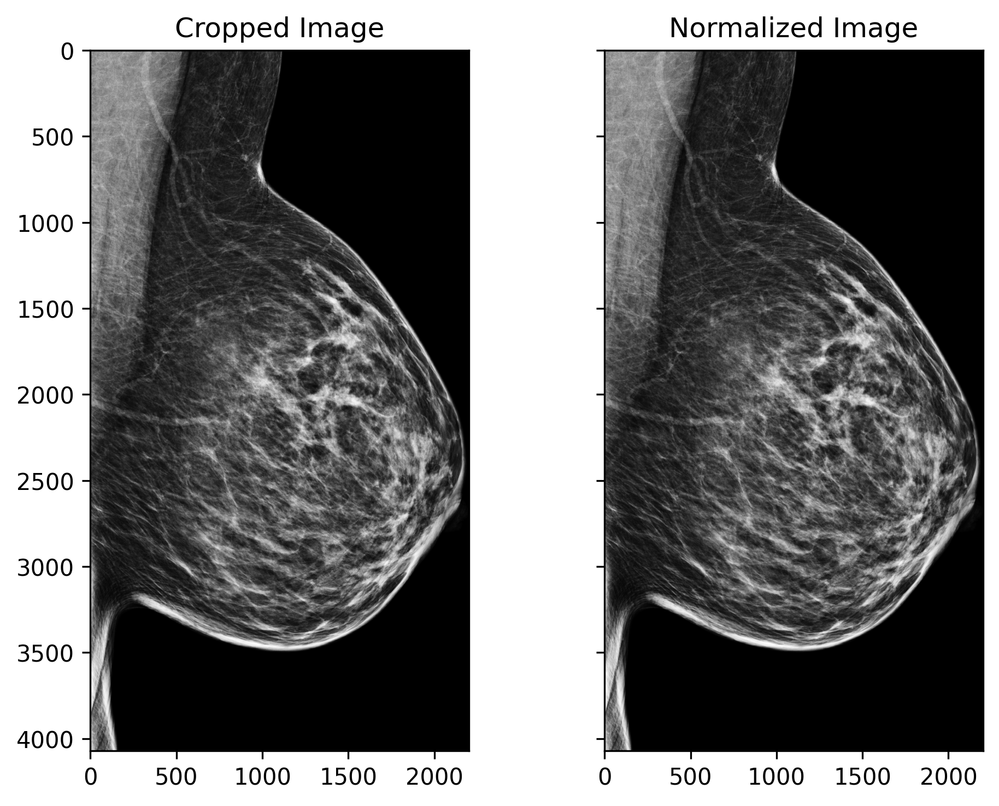

In [65]:
print(f"Cropped Image: (min={cropped_img.min():.2f}, max={cropped_img.max():.2f})")
print(f"Normalized Image: (min={normalized_img.min():.2f}, max={normalized_img.max():.2f})")

fig, axs = plt.subplots(1, 2, dpi=300, constrained_layout=True, sharey=True)
axs[0].imshow(cropped_img, 'gray')
axs[1].imshow(normalized_img, 'gray')
axs[0].set_title("Cropped Image")
axs[1].set_title("Normalized Image")
plt.show()

# 4.6.2. Standardization

The most common standardization technique is transforming the pixel distribution to a mean of zero and a standard deviation of 1 (or unit variance).

The steps are as follows:

1. Calculate the mean and standard deviation of the image
2. Subtract the image with it's mean
3. Divide the results with the standard deviation

In [66]:
img_mean = cropped_img.mean()
img_std = cropped_img.std()

In [67]:
standard_img = (cropped_img - img_mean) / img_std

In [68]:
standard_img.mean()

-5.785581961130134e-17

In [69]:
standard_img.std()

0.9999999999999998

Cropped Image: (mean=809.99, std=851.97)
Standardized Image: (mean=-0.00, std=1.00)


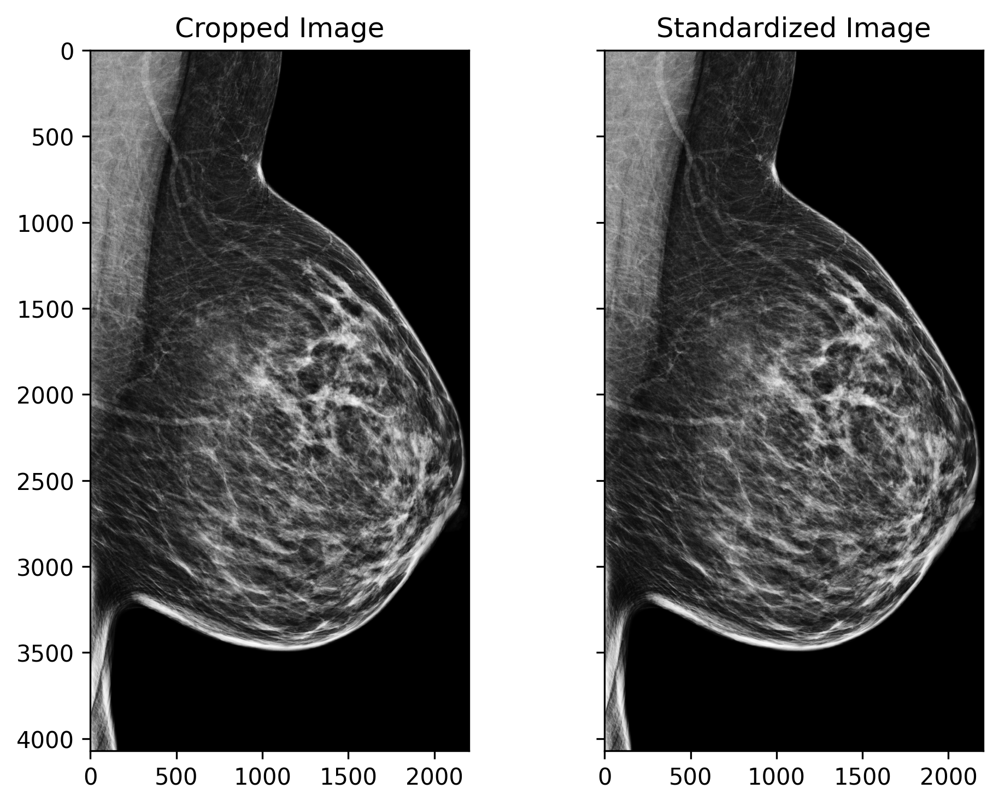

In [70]:
print(f"Cropped Image: (mean={cropped_img.mean():.2f}, std={cropped_img.std():.2f})")
print(f"Standardized Image: (mean={standard_img.mean():.2f}, std={standard_img.std():.2f})")

fig, axs = plt.subplots(1, 2, dpi=300, constrained_layout=True, sharey=True)
axs[0].imshow(cropped_img, 'gray')
axs[1].imshow(standard_img, 'gray')
axs[0].set_title("Cropped Image")
axs[1].set_title("Standardized Image")
plt.show()

# 5. DIGITAL BREAST TOMOSYNTHESIS (DBT)

![](https://www.researchgate.net/profile/Ernest-Ekpo/publication/265019671/figure/fig1/AS:295833489690637@1447543608853/Principles-of-digital-breast-tomosynthesis-a-tube-rotations-relative-to-the-detector.png)

([Source: Ekpo & McEntee, 2014](https://doi.org/10.1259/bjr.20140460))


## **Effect of additional angles**
![EBME](https://www.ebme.co.uk/images/arts/3D-Mammography/2D-v-3D.jpg)

([Source: EBME](https://www.ebme.co.uk/images/arts/3D-Mammography/2D-v-3D.jpg))

In [71]:
dbt_files = glob.glob("/fsx/embed/summer-school-24/Theo_session/dicoms/dbt/*.dcm")

In [72]:
dbt_dcm = pydicom.dcmread(dbt_files[0])

In [73]:
dbt_dcm

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 92
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: ''
(0002, 0003) Media Storage SOP Instance UID      UI: ''
(0002, 0010) Transfer Syntax UID                 UI: JPEG 2000 Image Compression (Lossless Only)
(0002, 0012) Implementation Class UID            UI: ''
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_366'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['DERIVED', 'PRIMARY']
(0008, 0016) SOP Class UID                       UI: Breast Tomosynthesis Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.3680043.8.498.47549109712830272343976680154292976297
(0008, 0020) Study Date                          DA: '2014-07-01 00:00:00'
(0008, 0021) Series 

In [74]:
dbt_image_stack = apply_voi_lut(apply_modality_lut(dbt_dcm.pixel_array, dbt_dcm), dbt_dcm)

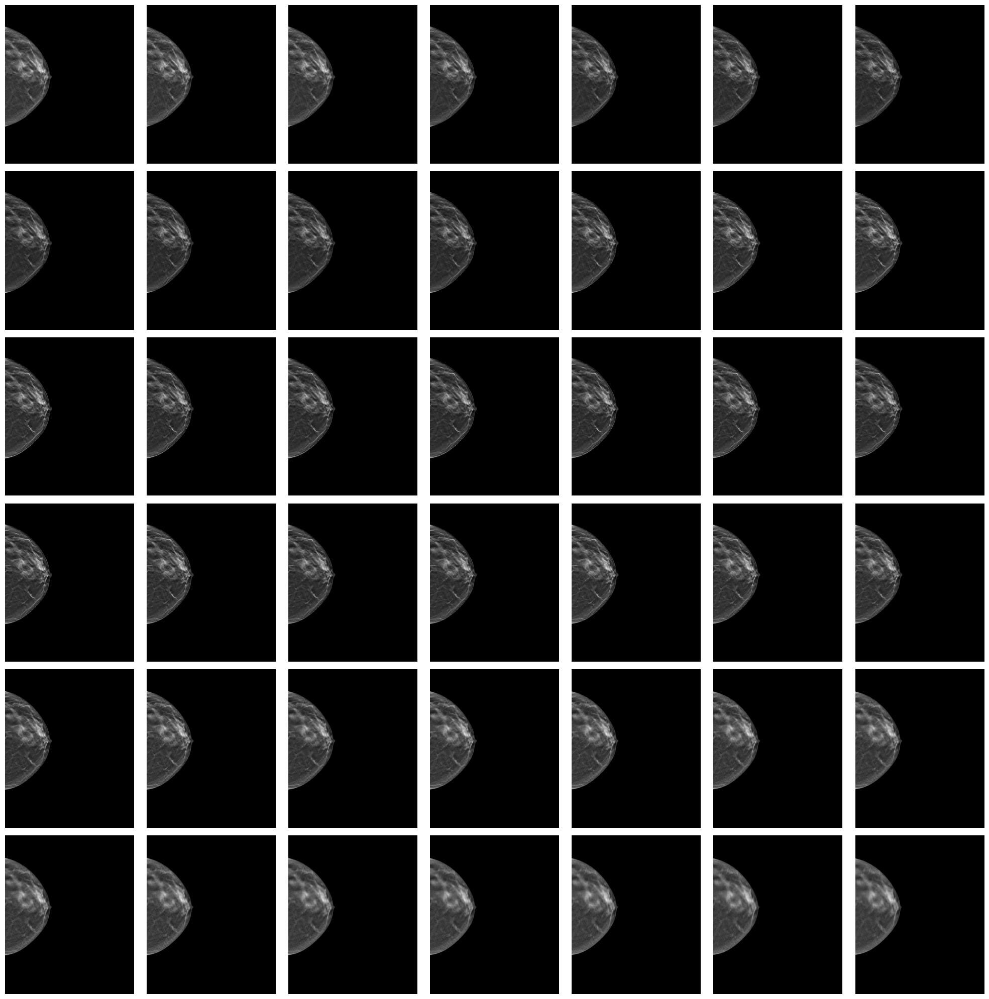

In [75]:
fig, axs = plt.subplots(6, 7, figsize=(20, 20), sharey=True, sharex=True, tight_layout=True)

for i, ax in enumerate(axs.flatten()):
    ax.imshow(np.rot90(dbt_image_stack[i], 2), 'gray')
    ax.set_axis_off()
plt.show()

In [76]:
animate_3d_array(np.rot90(dbt_image_stack, 2), vmin=dbt_image_stack.min(), vmax=dbt_image_stack.max())

## 5.2 Crop DBT

In [77]:
dbt_image_stack_sum = dbt_image_stack.sum(0)

In [78]:
_, binary_mask = cv2.threshold(dbt_image_stack_sum, np.ptp(dbt_image_stack_sum) * 0.0005 + dbt_image_stack_sum.min(), dbt_image_stack_sum.max(), cv2.THRESH_BINARY)

In [79]:
# Get the area
num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(binary_mask.astype(np.uint8), connectivity=8)

largest_area = 0
label_with_largest_area = None
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    print("Label:", i, "--> Area:", area)
    if area > largest_area:
        largest_area = area
        label_with_largest_area = i

Label: 1 --> Area: 792491


In [80]:
island_mask = np.zeros_like(binary_mask.astype(np.uint8))
island_mask[labels == label_with_largest_area] = 1

In [81]:
def crop_zeros(image, img_mask_, get_coords=True):
    points = np.argwhere(img_mask_.sum(axis=0))
    left_boundary = points.min()
    right_boundary = points.max()
    
    points = np.argwhere(img_mask_.sum(axis=1))
    top_boundary = points.min()
    bottom_boundary = points.max()

    if get_coords:
        return image[top_boundary:bottom_boundary, left_boundary: right_boundary], (top_boundary, bottom_boundary, left_boundary, right_boundary)
    else:
        return image[top_boundary:bottom_boundary, left_boundary: right_boundary]

In [82]:
dbt_cropped_image, dbt_coords = crop_zeros(dbt_image_stack_sum, island_mask)

In [83]:
dbt_image_stack_cropped = dbt_image_stack[:, dbt_coords[0]:dbt_coords[1], dbt_coords[2]:dbt_coords[3]]

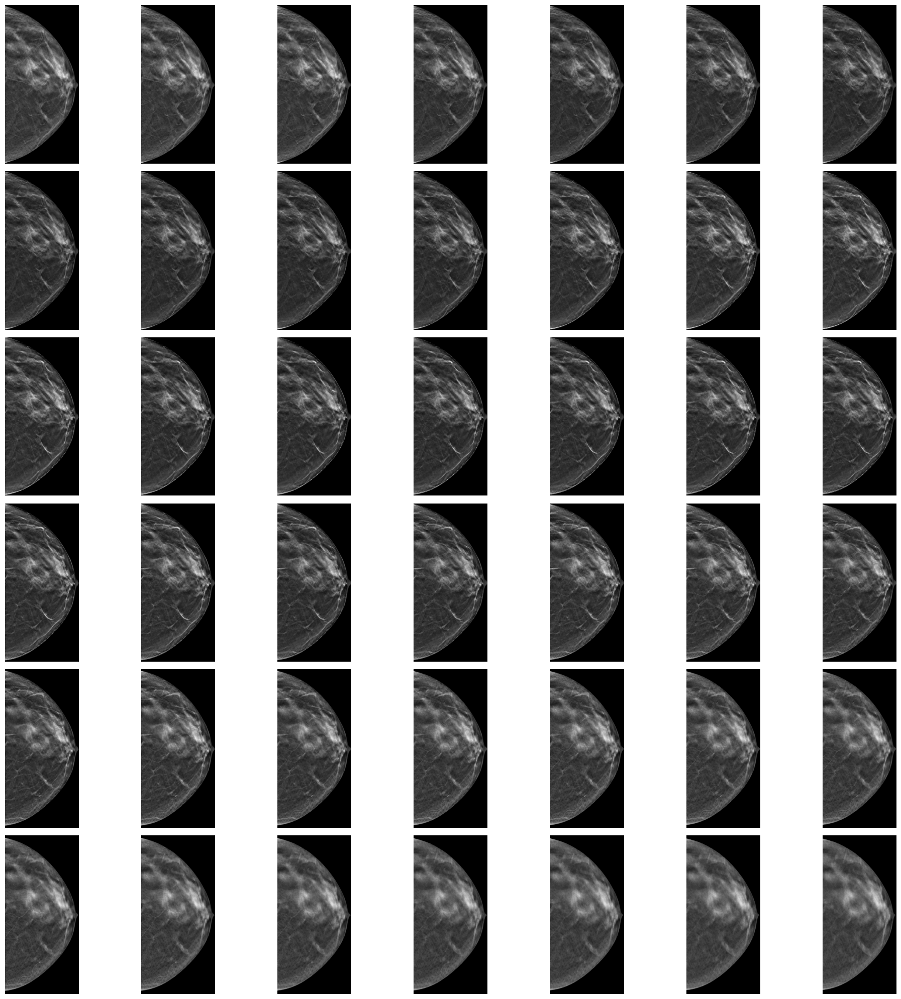

In [84]:
fig, axs = plt.subplots(6, 7, figsize=(20, 20), sharey=True, sharex=True, tight_layout=True)

for i, ax in enumerate(axs.flatten()):
    ax.imshow(np.rot90(dbt_image_stack_cropped[i], 2), 'gray')
    ax.set_axis_off()
plt.show()

In [85]:
animate_3d_array(np.rot90(dbt_image_stack_cropped, 2), vmin=dbt_image_stack_cropped.min(), vmax=dbt_image_stack_cropped.max())

# 6. MRI


![American Cancer Society](https://www.cancer.org/adobe/dynamicmedia/deliver/dm-aid--d3bfc9ec-f1f1-4371-b9c5-16f83d549791/breast-mri.gif?width=1440&quality=82&preferwebp=true)

([Source: American Cancer Society](https://www.cancer.org/adobe/dynamicmedia/deliver/dm-aid--d3bfc9ec-f1f1-4371-b9c5-16f83d549791/breast-mri.gif?width=1440&quality=82&preferwebp=true))


## Reconstruction

![](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4276738/bin/nihms-605420-f0001.jpg)

([Source: Hansen & Kellman, 2014](https://doi.org/10.1002%2Fjmri.24687))

In [86]:
mri_sample = pd.read_csv("/fsx/embed/summer-school-24/Theo_session/tables/mri_sample_df.csv")

In [87]:
mri_sample.StudyDescription.value_counts(dropna=False)

StudyDescription
MRI BREAST W  WO CONTRAST BILATERAL    1023
Name: count, dtype: int64

In [88]:
mri_sample.SeriesDescription.value_counts(dropna=False)

SeriesDescription
SAG T1 VIBRANT POST       120
AX VIBRANT                114
AX VIBRANT DYNAMIC        112
Ph2/AX VIBRANT DYNAMIC    112
Ph3/AX VIBRANT DYNAMIC    112
Ph4/AX VIBRANT DYNAMIC    112
Ph1/AX VIBRANT DYNAMIC    112
Ph5/AX VIBRANT DYNAMIC    112
Ax T2 STIR                 47
RT SAG T2 FS               35
LT SAG T2 FS               35
Name: count, dtype: int64

In [89]:
mri_sample_axial = mri_sample[mri_sample.SeriesDescription=="AX VIBRANT DYNAMIC"]

In [90]:
mri_sample_axial = mri_sample_axial.sort_values(["InstanceNumber"])

In [91]:
loaded_mri_dicoms = []
for dcm_path in tqdm(mri_sample_axial["anon_dicom_path"]):
    # print(dcm_path)
    loaded_mri_dicoms.append(pydicom.dcmread(dcm_path))

100%|██████████| 112/112 [00:00<00:00, 918.78it/s]


In [ ]:
pixel_spacing = loaded_mri_dicoms[0].PixelSpacing
slice_thickness = loaded_mri_dicoms[0].SliceThickness

In [ ]:
ax_aspect = pixel_spacing[1]/pixel_spacing[0]
sag_aspect = slice_thickness/pixel_spacing[0]
cor_aspect = slice_thickness/pixel_spacing[1]

In [ ]:
images = np.zeros((len(loaded_mri_dicoms), loaded_mri_dicoms[0].Rows, loaded_mri_dicoms[0].Columns))

In [ ]:
for i, dcm_ in enumerate(loaded_mri_dicoms):
    images[i] = process_dicom_image(dcm_)

In [ ]:
images_coronal = images.transpose((1, 0, 2))
images_sagital = images.transpose((2, 0, 1))

In [ ]:
fig, axs = plt.subplots(10, 5, figsize=(20, 40), sharey=True, sharex=True, tight_layout=True)
fig.suptitle("Axial", fontsize=24)
starting_slice = 30
skip_slice = 0
for i, ax in enumerate(axs.flatten()):
    ax.imshow(np.rot90(images[starting_slice+i+i*skip_slice], 2), 'gray', vmin=np.iinfo(np.int16).min, vmax=np.iinfo(np.int16).max)
    ax.set_aspect(ax_aspect)
    ax.set_axis_off()
plt.show()

In [ ]:
animate_3d_array(np.rot90(images, 2))

In [ ]:
fig, axs = plt.subplots(10, 5, figsize=(20, 40), sharey=True, sharex=True, tight_layout=True)
starting_slice = 90
skip_slice = 2
for i, ax in enumerate(axs.flatten()):
    ax.imshow(np.rot90(images_coronal[starting_slice+i+i*skip_slice], 2), 'gray', vmin=np.iinfo(np.int16).min, vmax=np.iinfo(np.int16).max)
    ax.set_aspect(cor_aspect)
    ax.set_axis_off()
plt.show()

In [ ]:
images_coronal_fliplr_flip_ud = np.flipud(np.fliplr(images_coronal[:240]))

In [ ]:
animate_3d_array(images_coronal_fliplr_flip_ud, aspect_ratio=cor_aspect)

In [ ]:
fig, axs = plt.subplots(10, 5, figsize=(20, 40), sharey=True, sharex=True, tight_layout=True)
starting_slice = 100
skip_slice = 5
for i, ax in enumerate(axs.flatten()):
    ax.imshow(np.rot90(images_sagital[starting_slice+i+i*skip_slice], 2), 'gray', vmin=np.iinfo(np.int16).min, vmax=np.iinfo(np.int16).max)
    ax.set_aspect(sag_aspect)
    ax.set_axis_off()
plt.show()

In [ ]:
animate_3d_array(np.rot90(images_sagital, 2), aspect_ratio=sag_aspect)

### ☢️ ***Exercise 4***

Load and visualize a true SAGITAL series.

What main differences do you see compared with the resliced Sagital view above?

In [ ]:
# Code your solution here